In [1]:
%%capture

!git clone https://github.com/apple/ml-depth-pro.git

In [2]:
!cp -r /content/ml-depth-pro/src/depth_pro/* /content
!cp -r /content/ml-depth-pro/*  /content


In [51]:
!rm -r /content/ml-depth-pro

In [3]:
%%capture
!pip install -e .

In [4]:
%%capture

!pip install ultralytics

In [5]:
!source get_pretrained_models.sh

--2024-10-27 00:09:55--  https://ml-site.cdn-apple.com/models/depth-pro/depth_pro.pt
Resolving ml-site.cdn-apple.com (ml-site.cdn-apple.com)... 17.253.83.205, 17.253.83.199, 2620:149:a21:f100::196, ...
Connecting to ml-site.cdn-apple.com (ml-site.cdn-apple.com)|17.253.83.205|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1904446787 (1.8G) [binary/octet-stream]
Saving to: ‘checkpoints/depth_pro.pt’

depth_pro.pt        100%[===================>]   1.77G   106MB/s    in 16s     

2024-10-27 00:10:11 (115 MB/s) - ‘checkpoints/depth_pro.pt’ saved [1904446787/1904446787]



In [6]:
!pip install -q transformers

In [1]:
from transformers import AutoImageProcessor, AutoModelForDepthEstimation
from PIL import Image
import cv2
from ultralytics import YOLO
import torch
import numpy as np
import random

In [2]:
from google.colab.patches import cv2_imshow


In [3]:
import gc


In [4]:
from PIL import Image
import depth_pro
from utils import load_rgb


In [5]:
!export PYTORCH_CUDA_ALLOC_CONF=expandable_segments:True

In [37]:
image_path='/content/IMG_20240511_165243.jpg'

In [38]:
image=cv2.imread(image_path)
im1=image.copy()

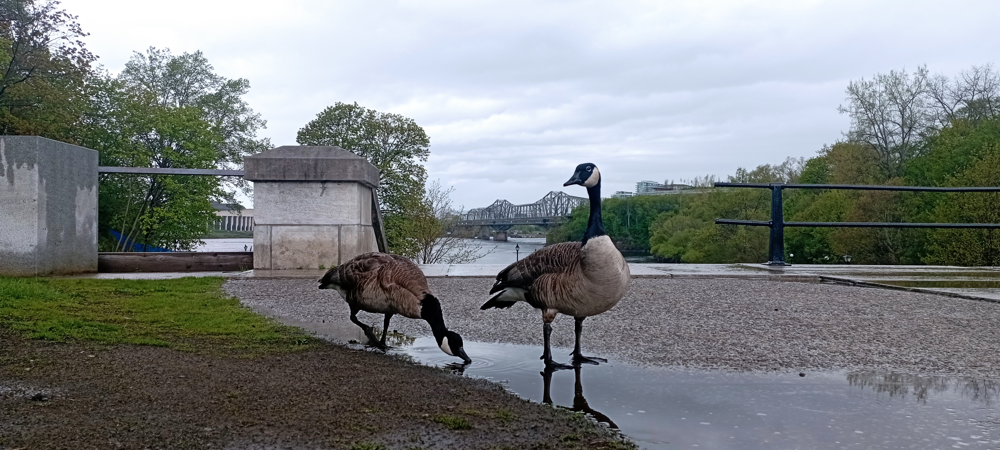

In [39]:
cv2_imshow( im1)

In [9]:

# Load model and preprocessing transform
model_d, transform = depth_pro.create_model_and_transforms()
model_d.eval()

DepthPro(
  (encoder): DepthProEncoder(
    (patch_encoder): VisionTransformer(
      (patch_embed): PatchEmbed(
        (proj): Conv2d(3, 1024, kernel_size=(16, 16), stride=(16, 16))
        (norm): Identity()
      )
      (pos_drop): Dropout(p=0.0, inplace=False)
      (patch_drop): Identity()
      (norm_pre): Identity()
      (blocks): Sequential(
        (0): Block(
          (norm1): LayerNorm((1024,), eps=1e-06, elementwise_affine=True)
          (attn): Attention(
            (qkv): Linear(in_features=1024, out_features=3072, bias=True)
            (q_norm): Identity()
            (k_norm): Identity()
            (attn_drop): Dropout(p=0.0, inplace=False)
            (proj): Linear(in_features=1024, out_features=1024, bias=True)
            (proj_drop): Dropout(p=0.0, inplace=False)
          )
          (ls1): LayerScale()
          (drop_path1): Identity()
          (norm2): LayerNorm((1024,), eps=1e-06, elementwise_affine=True)
          (mlp): Mlp(
            (fc1): Linea

In [40]:
f_px = None   # check this https://github.com/apple/ml-depth-pro/issues/21#issuecomment-2397643379 to understand


In [41]:
image = transform(image)

In [42]:
%%time
# Run inference.
prediction = model_d.infer(image, f_px=f_px)
depth = prediction["depth"]  # Depth in [m].
focallength_px = prediction["focallength_px"]  # Focal length in pixels.

CPU times: user 1.34 s, sys: 2.07 s, total: 3.41 s
Wall time: 3.43 s


In [43]:
depth

tensor([[ 3.7804,  3.9279,  5.0824,  ..., 30.7261, 30.8259, 30.8431],
        [ 6.8510,  6.9393,  7.5023,  ..., 37.2753, 39.7645, 40.2261],
        [ 8.5768,  8.5599,  8.4628,  ..., 26.3573, 25.0865, 24.8804],
        ...,
        [ 0.8204,  0.8201,  0.8180,  ...,  0.9075,  0.9093,  0.9096],
        [ 0.8172,  0.8168,  0.8143,  ...,  0.9109,  0.9172,  0.9183],
        [ 0.8148,  0.8154,  0.8189,  ...,  0.9085,  0.9140,  0.9149]], device='cuda:0')

In [44]:
depth.squeeze().cpu().numpy()

array([[     3.7804,      3.9279,      5.0824, ...,      30.726,      30.826,      30.843],
       [      6.851,      6.9393,      7.5023, ...,      37.275,      39.764,      40.226],
       [     8.5768,      8.5599,      8.4628, ...,      26.357,      25.087,       24.88],
       ...,
       [     0.8204,     0.82005,     0.81801, ...,     0.90746,     0.90927,     0.90959],
       [     0.8172,     0.81678,     0.81431, ...,     0.91094,     0.91723,     0.91832],
       [    0.81479,     0.81538,     0.81886, ...,     0.90853,     0.91395,     0.91489]], dtype=float32)

In [45]:
model = YOLO('yolov8s.pt')  # pretrained YOLOv8n model


In [46]:

%%time
results = model(im1  ,conf=0.1)# predict on an image


0: 320x640 2 birds, 43.7ms
Speed: 2.3ms preprocess, 43.7ms inference, 2.1ms postprocess per image at shape (1, 3, 320, 640)
CPU times: user 251 ms, sys: 6.67 ms, total: 258 ms
Wall time: 260 ms


In [47]:
colors=np.random.uniform(low=0,high=255,size=(80,3))

In [48]:
names = list(results[0].names.values())

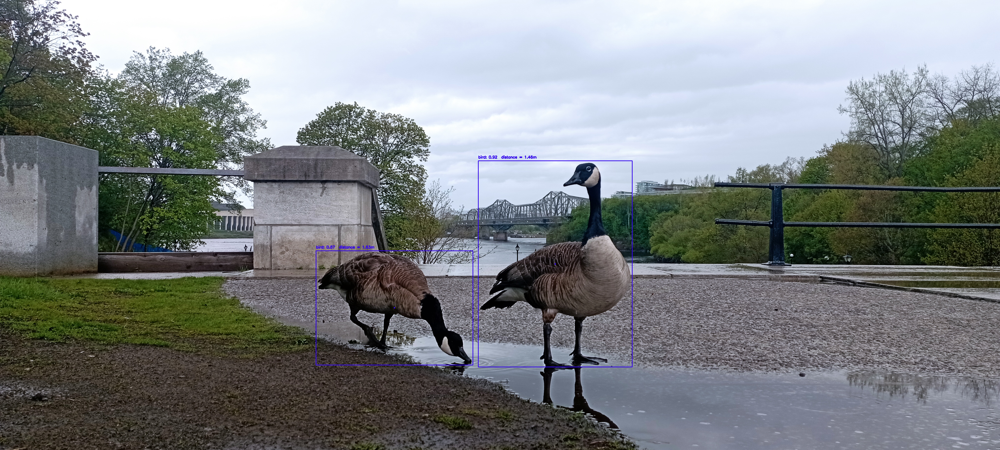

In [52]:
bboxs=[]
boxes = results[0].boxes

for obj in boxes.data:
  x, y, w,h=obj[0:4]
  bboxs.append(obj[0:4])
  lab=int(obj[5])
  prob=obj[4]
  distance=depth[int((y+h)/2)][int((x+w)/2)]
  cv2.rectangle(im1, (int(x), int(y)), (int(w), int(h)), colors[lab],2)
  cv2.circle(im1, (int((x+w)/2),int((y+h)/2)), radius=0, color=colors[lab], thickness=5)
  try:
    text = f"{names[lab]}: {prob:.2f}  distance = {distance.item():.2f}m"
  except ValueError:
    text = f"{names[lab]}: {prob:.2f}  distance = N/A"
  cv2.putText(im1, text, (int(x), int(y)-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, colors[lab], 2)

cv2_imshow( im1)

In [50]:
# Clear GPU cache and free memory
torch.cuda.empty_cache()
gc.collect()

3029